In [1]:
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import h5py
import thunder as td
import regression as regr
from skimage.io import imread, imsave
from scipy.signal import fftconvolve
from scipy.stats import zscore
from fish.image.alignment import estimate_translation
from fish.image.vol import proj_plot
import factorization as fct

%matplotlib inline

In [2]:
def h5_loader(fname):
    from h5py import File
    with File(fname) as f:
        return f['default'].value

accessors = {}
accessors['h5'] = h5_loader
accessors['tif'] = imread

def ax_format(ax):
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')


def load_matfile(fname, base_name='data'):
    from h5py import File
    data = {}
    with File(fname) as f:    
        var_names = list(f[base_name].keys())
        for v in var_names:
            data[v] = np.squeeze(f[base_name][v].value)
    return data

def biexponential_kernel(kernel_width, rise, decay):
    from numpy import linspace, exp, zeros, hstack
    xrange = linspace(0, 10, kernel_width)
    kernel = exp(xrange * decay) - exp(xrange * rise)
    pad = zeros(kernel.shape)
    kernel = hstack([pad, kernel])
    kernel /= kernel.sum()
    return kernel

In [3]:
base_dirs = ('/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20161012/20161012_1_1_cy221_6dpf_0gain_wholebrain_20161012_113040/',
             '/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20161109/fish2/20161109_2_1_6dpf_GFAP_GC_Huc_RG_GA_CL_fb_OL_f0_0GAIN_20161109_211950/',
            '/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20160204/20160204_2_2_cy14_nucRFP_0GAIN_multipleprobe_20160204_123255/',
            '/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20161126/fish3/20161126_3_1_th1gc6s_gfapGC_6dpf_CLpause_0gain_20161126_163256/',
            '/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20161130/fish3/20161130_3_1_th1gc6s_gfapgc_7dpf_lightdark_0gain_20161130_215044/',
            '/groups/ahrens/ahrenslab/FROM_TIER2/Yu/SPIM/active_datasets/20161117/fish2/20161117_2_1_GFAP_H2BGC_7dpf_GA_CLf0_OLf0_0gain_before_20161117_133410/')

base_dir = base_dirs[0]
fnames = glob(base_dir + '/raw/TM*')
im_fmt = fnames[0].split('.')[-1]
fnames.sort()
print(len(fnames))

6750


## Build the design matrix

In [4]:
swim_fname = base_dir + 'ephys/data.mat'
raw_ephys_fname = base_dir + 'ephys/rawdata.mat'
swim_data = load_matfile(swim_fname)
raw_ephys_data = load_matfile(raw_ephys_fname, 'rawdata')
cam = swim_data['frame']
frame_signal = (np.diff(cam)[:-1] < 1) & (np.diff(cam)[1:] > 0)
frame_times = np.where(frame_signal)[0]
print('Frames detected in ephys: {0}'.format(len(frame_times)))

Frames detected in ephys: 6750


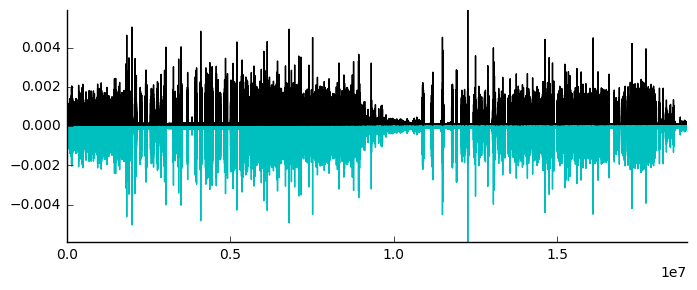

In [5]:
fig, axs = plt.subplots(figsize=(8,3))
axs.plot(swim_data['fltCh1'], color='k')
axs.plot(-swim_data['fltCh2'], color='c')
axs.axis('tight')
ax_format(axs)

In [6]:
%%time
# normalize the swim signal to [0,1]
swim_signal = swim_data['fltCh1'].copy()
swim_signal -= swim_signal.min()
swim_signal /= swim_signal.max()

starts = swim_data['swimStartIndT'].copy().astype('int')
stops = swim_data['swimEndIndT'].copy().astype('int')
swim_power = swim_data['swimPower1'].copy()

condition_signal =  raw_ephys_data['stimParam3']
gain_signal = raw_ephys_data['stimGain']
cl_thr = 30
cl_epoch = np.where(condition_signal < cl_thr)[0]
ol_epoch = np.where(condition_signal > cl_thr)[0]

cl_stops = stops[np.in1d(stops, cl_epoch, assume_unique=True)]
interbout = starts[1:] - stops[:-1]

# threshold in ephys samples for defining an inter-bout interval as GU
gu_thr = 40000
gu_events = np.where(interbout > gu_thr)[0]

# only keep stops in the open loop epoch
gu_events = gu_events[np.in1d(stops[gu_events], ol_epoch, assume_unique=True)]

# set the earliest timepoint to count as a giving up event
earliest = 30 * 6000
power_thr = 0.1
gu_events = gu_events[stops[gu_events] > earliest]
gu_events = gu_events[swim_power[gu_events] > power_thr]

gu_signal = np.zeros(swim_signal.shape)
gu_signal[stops[gu_events]] = 1

kern_swim = biexponential_kernel(12001, -10, -2)
kern_gu = biexponential_kernel(180001, -1.1, -3.9)
# clip the x axis of the gu kernel so that it doesn't overlap with the next swim bout
kern_gu = kern_gu[(len(kern_gu) // 2 - gu_thr ): (len(kern_gu) // 2 + gu_thr )]

# using fftconvolve is faster but less reliable for this purpose, for some reason.
flt_swim = fftconvolve(swim_signal - swim_signal.mean(), kern_swim, 'same')
flt_gu = fftconvolve(gu_signal, kern_gu, 'same')

CPU times: user 5.61 s, sys: 919 ms, total: 6.53 s
Wall time: 6.54 s


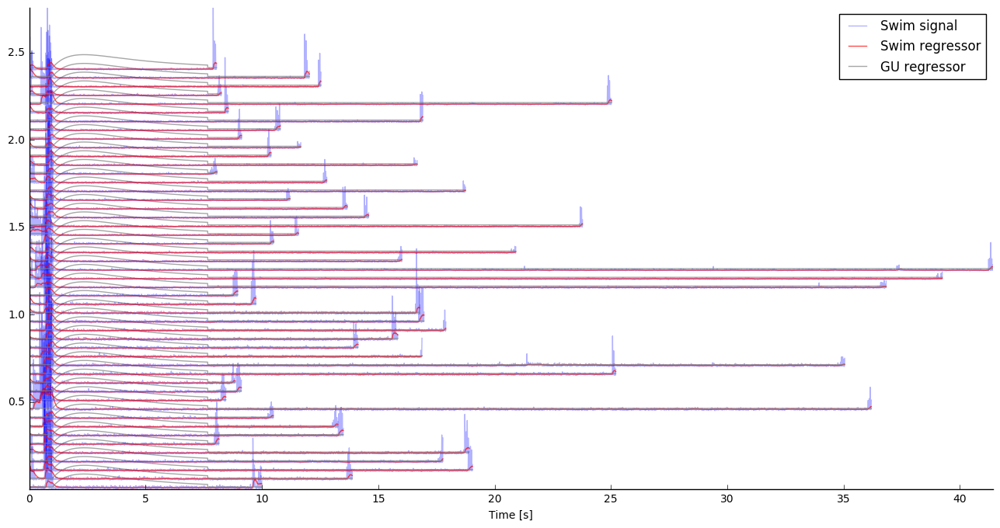

In [7]:
nr = len(gu_events)
fig, axs = plt.subplots(nrows = 1, figsize=(16,8))
for ind, gu_ind in enumerate(np.arange(len(gu_events))):
    ax = axs
    offset = ind * .05
    plr = slice(stops[gu_events[gu_ind]] - 6000, stops[min(gu_events[gu_ind] + 1, len(stops)-1)])
    xaxis = np.arange(plr.stop-plr.start) / 6000
    ax.plot(xaxis, offset + swim_signal[plr], alpha = .3, label='swim', color='b')
    ax.plot(xaxis, offset + flt_swim[plr] + swim_signal.mean(), linewidth=1, alpha = .7, label = 'swim regressor', color='r')
    ax.plot(xaxis, offset + 2000 * flt_gu[plr] + swim_signal.mean(), linewidth=1, alpha = .7, label = 'gu regressor', color='gray')    
axs.axis('tight')
ax.set_xlabel('Time [s]')
ax.legend(('Swim signal','Swim regressor','GU regressor'))
ax_format(ax)

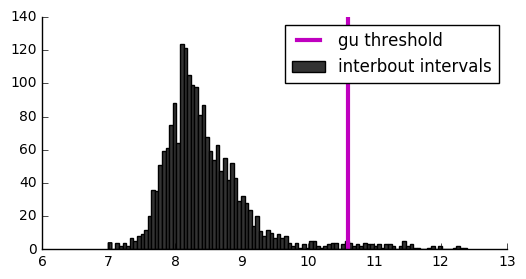

In [8]:
fig, axs = plt.subplots(figsize=(6,3))
axs.hist(np.log(interbout), 100, facecolor=[.2,.2,.2], label='interbout intervals');
axs.axvline(np.log(gu_thr), color='m', label='gu threshold', linewidth=3)
axs.legend()
ax_format(axs)

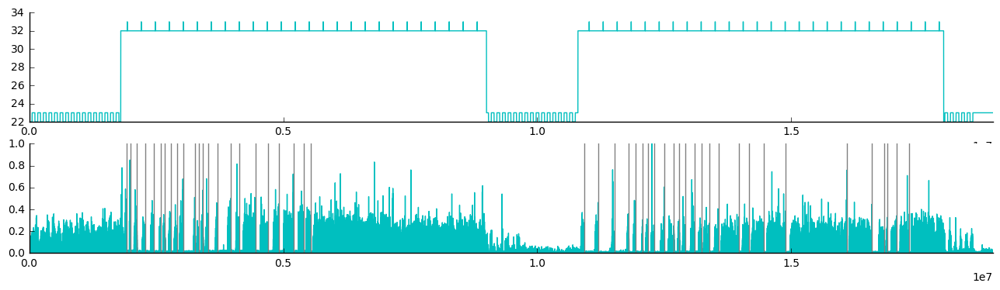

In [9]:
fig, axs = plt.subplots(nrows=2, figsize=(16,4))
plr = np.arange(0, len(swim_signal))
axs[0].plot(plr, condition_signal[plr],color='c')
axs[1].plot(plr, swim_signal[plr], color='c')
[ax.set_xlim(plr[[0,-1]]) for ax in axs]
[ax_format(ax) for ax in axs]
for g in gu_events:
    if stops[g] in plr:
        axs[1].axvline(stops[g], color='gray')

In [10]:
from scipy.ndimage.interpolation import shift
# build regression matrices
swim_lags = [0]
gu_lags = [0]

matrix_length = min(len(frame_times), len(fnames))

swim_matrix = np.zeros([len(swim_lags), matrix_length])
gu_matrix = np.zeros([len(gu_lags), matrix_length])

for ind, slag in enumerate(swim_lags):
    swim_matrix[ind] = shift(flt_swim[frame_times[:matrix_length]], slag)

for ind, glag in enumerate(gu_lags):
    gu_matrix[ind] = shift(flt_gu[frame_times[:matrix_length]], glag)
    
motor_matrix = np.vstack([swim_matrix, gu_matrix])

In [11]:
from scipy.ndimage.filters import median_filter

In [12]:
ims = td.images.fromlist(fnames, accessor=accessors[im_fmt], engine=sc, npartitions=len(fnames)).median_filter(size=(1,3,3)).astype('float32')

## Check if registration parameters already exist; if so, load them. otherwise, calculate registration

In [13]:
%%time
do_registration = False

# load reference image in any case, since we want to threshold our image later
ref_range = (len(fnames) // 2) + np.arange(-5,5)
ref = td.images.fromlist(np.array(fnames)[ref_range], accessor=accessors[im_fmt]).mean().toarray().astype('float32')

# save reference image to disk 
imsave(base_dir + 'anat_reference.tif', ref)

try:
    affs = np.load(base_dir + 'regparams_affine.npy')
except(FileNotFoundError):
    do_registration = True

if do_registration:
    reg = ims.map(lambda v: estimate_translation(ref.max(0), v.max(0))).toarray()
    affs = np.array([r.affine for r in reg])
    np.save(base_dir + 'regparams_affine.npy', affs)

CPU times: user 8.51 s, sys: 1.19 s, total: 9.7 s
Wall time: 18.8 s


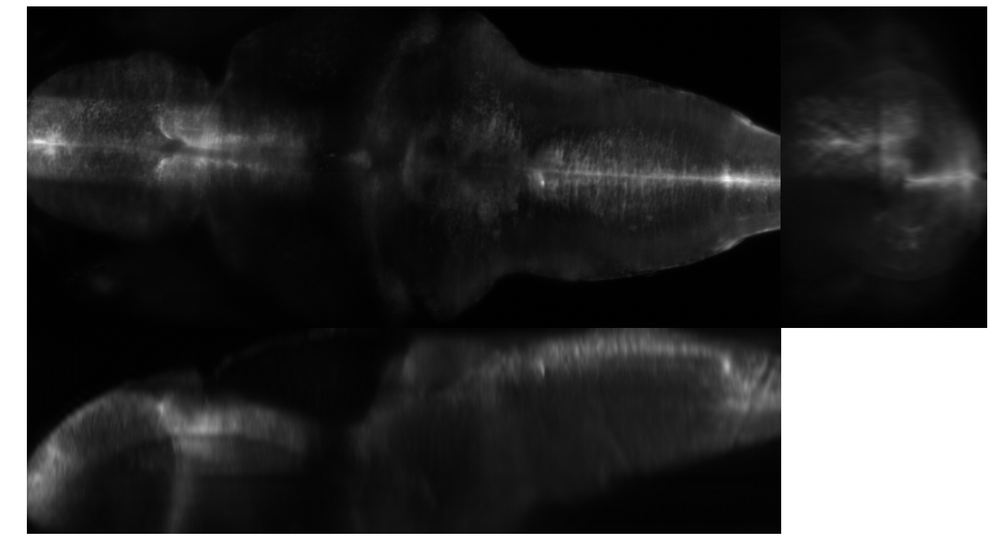

In [14]:
proj_plot(ref, np.std, aspect=(16,1,1), figsize=15);

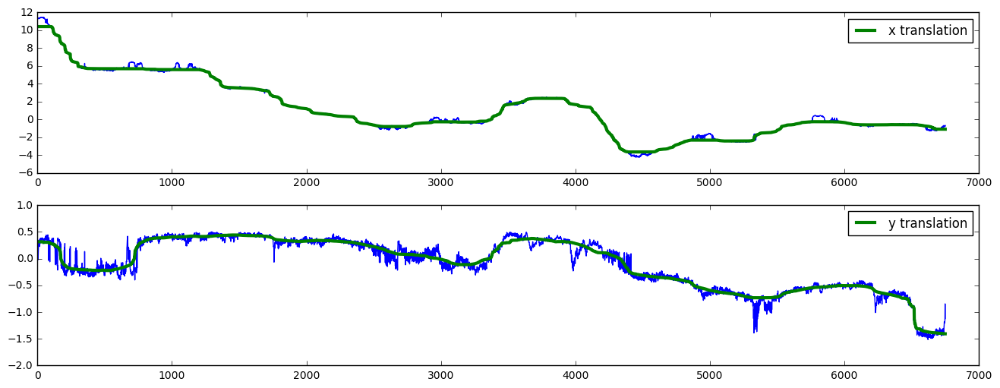

In [15]:
from scipy.ndimage.filters import median_filter
fig, axs = plt.subplots(nrows=2, figsize=(16,6))
x_trans_raw = affs[:, -2, -1]
y_trans_raw = affs[:, 0, -1]
x_trans = median_filter(x_trans_raw, size=400)
y_trans = median_filter(y_trans_raw, size=400)
z_trans = np.zeros(x_trans.shape)
trans = np.vstack([z_trans, y_trans, x_trans])

axs[0].plot(x_trans_raw)
axs[0].plot(x_trans, linewidth=3, label = 'x translation')
axs[0].legend()
axs[1].plot(y_trans_raw)
axs[1].plot(y_trans, linewidth=3, label = 'y translation')
axs[1].legend()

## Add motion parameters as covariates to our design matrix

In [16]:
from scipy.stats import zscore
full_matrix = zscore(np.vstack([motor_matrix, y_trans, x_trans]), axis=1)

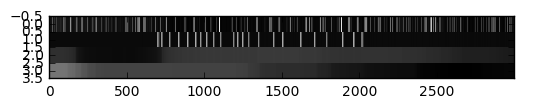

In [17]:
plt.imshow(full_matrix[:,0:3000], aspect=100, interpolation='None', cmap='gray')

## Correct for drift

In [18]:
from scipy.ndimage.interpolation import shift
# important to apply -1 * translation
ims_registered = ims.map(lambda v: shift(v[1], -trans[:, v[0][0]], mode='wrap'), with_keys=True)

## Gaussian blurring before images -> series conversion

In [19]:
ims_registered.shape

(6750, 35, 876, 2048)

In [20]:
%%time
sigma=(0,2,2)
ser = ims_registered.astype('float32').gaussian_filter(sigma=sigma)[:,:,::2,::2].toseries().normalize(method = 'window', window=500).astype('float32').cache()
ser.count()

CPU times: user 7.02 s, sys: 1.34 s, total: 8.36 s
Wall time: 54min 7s


## Todo: Filter out background pixels by intensity

In [21]:
# mask = median_filter(ref > 103, size=(1,3,3))

In [22]:
%%time
model = regr.FastLinearRegression().fit(full_matrix.T, ser)
results = model.betas_and_scores.toarray().astype('float32')

CPU times: user 39.4 s, sys: 2.17 s, total: 41.6 s
Wall time: 5min 8s


In [23]:
betas = results[:, :, :, :-1]
scores = results[:, :, :, -1]

In [24]:
np.save(base_dir + 'regression_r2.npy', scores)
np.save(base_dir + 'regression_betas.npy', betas)

In [25]:
scores = np.load(base_dir + 'regression_r2.npy')
betas = np.load(base_dir + 'regression_betas.npy')

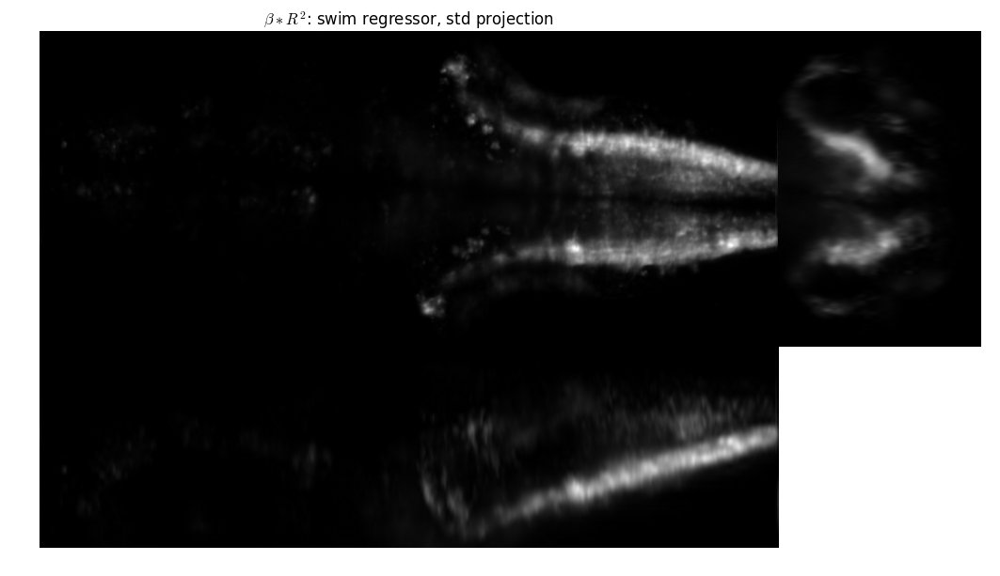

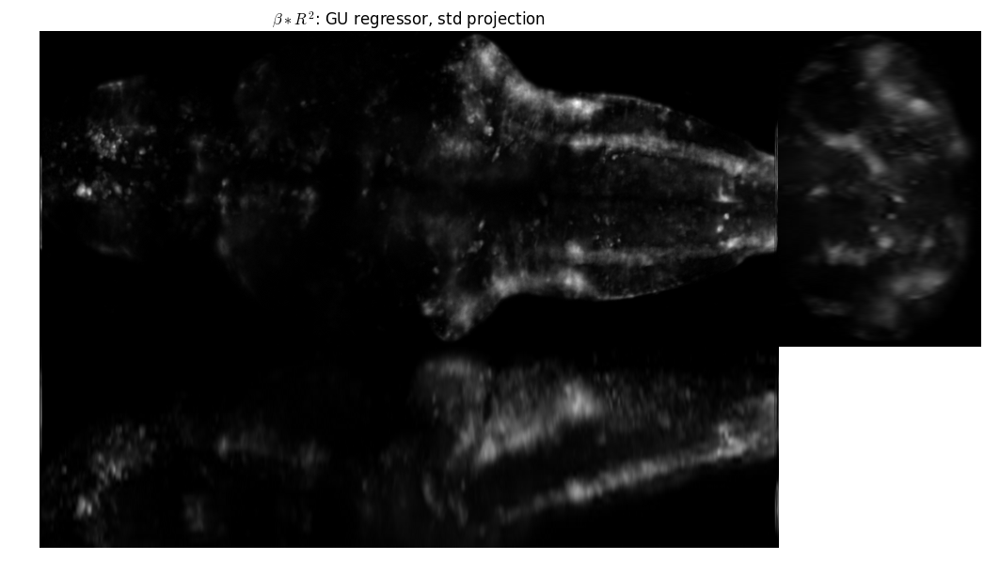

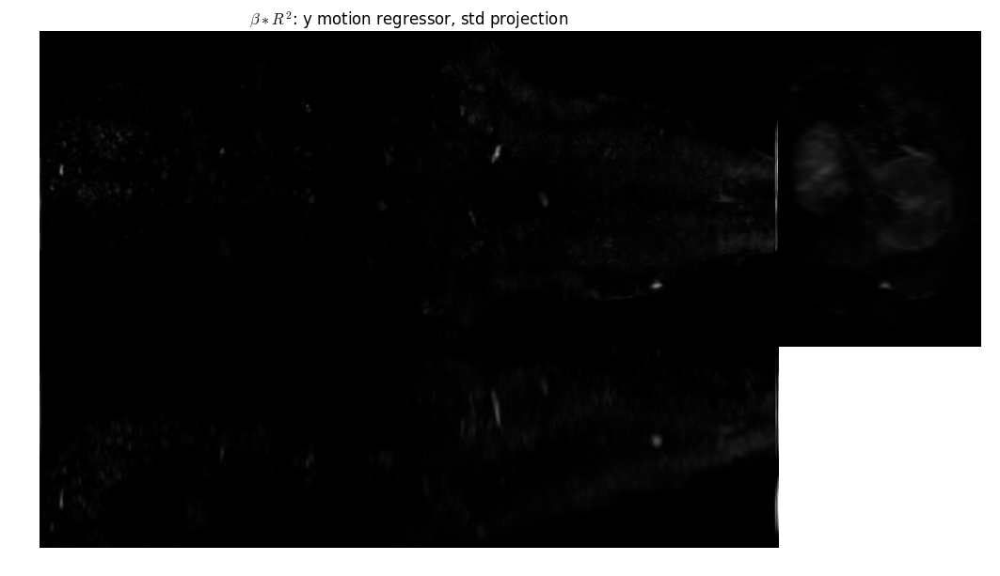

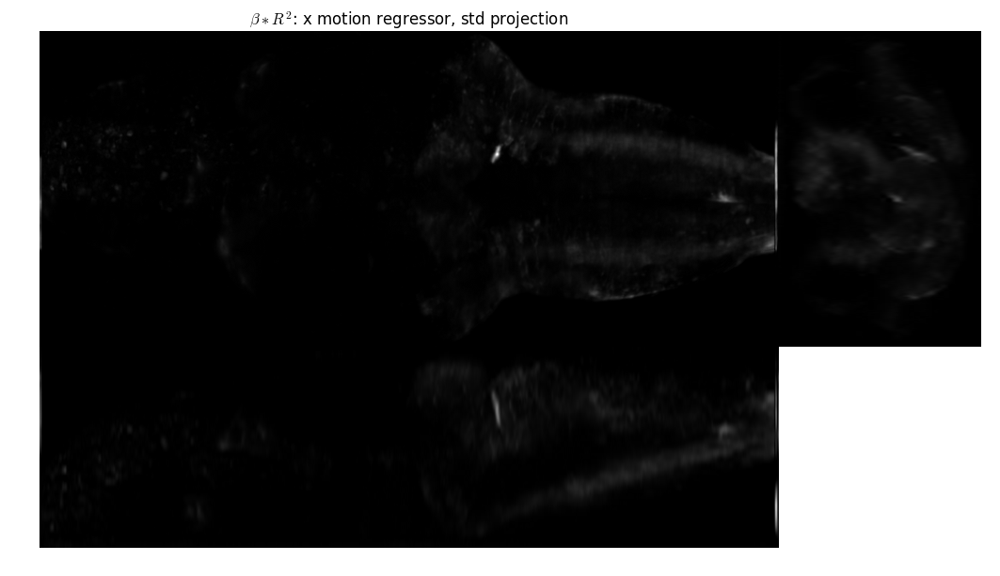

In [26]:
to_plot = np.arange(1,5)
axs = []
for ind, x in enumerate(to_plot):
    im = (betas[:,:,:,x] * scores)
    axs.append(proj_plot(np.abs(im), np.std, cmap='gray', aspect=(8,1,1), figsize=10))

axs[0][0][0].set_title(r'$\beta * R^2$: swim regressor, std projection')
axs[1][0][0].set_title(r'$\beta * R^2$: GU regressor, std projection')
axs[2][0][0].set_title(r'$\beta * R^2$: y motion regressor, std projection')
axs[3][0][0].set_title(r'$\beta * R^2$: x motion regressor, std projection')

In [27]:
betas.shape

(35, 438, 1024, 5)

In [181]:
# make masks for swim and giving-up brain regions based on regression results
masks = []
roi = [slice(0, None), slice(0, None), slice(0, None), slice(1,2)]
masks.append(np.squeeze(betas[roi]) * scores[roi[:-1]])
roi = [slice(0, None), slice(0, None), slice(0, None), slice(2,3)]
masks.append(np.squeeze(betas[roi]) * scores[roi[:-1]])

mask_thr = 95
masks[0] = np.abs(masks[0]) > np.percentile(np.abs(masks[0]), mask_thr)
masks[1] = np.abs(masks[1]) > np.percentile(np.abs(masks[1]), mask_thr)

masks = np.array([median_filter(m, size=(1,8,8)) for m in masks])

# trim stuff off the edges of the image to avoid artifacts from registration
border = 10
masks[:,:,:border,:] = 0
masks[:,:,-border:,:] = 0
masks[:,:,:,:border] = 0
masks[:,:,:,-border:] = 0

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x2b2e1e76f048>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x2b2e1e874c18>]], dtype=object)

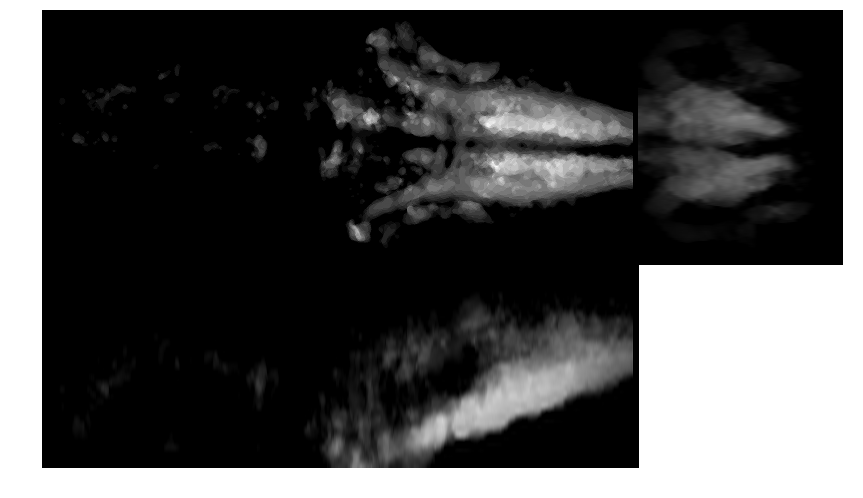

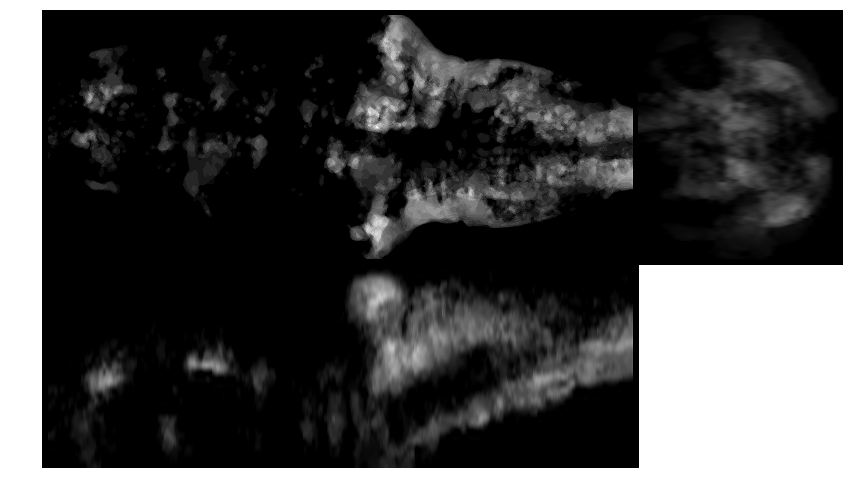

In [182]:
proj_plot(masks[0], np.mean, aspect=(10,1,1), figsize=8)
proj_plot(masks[1], np.mean, aspect=(10,1,1), figsize=8)

In [30]:
keys = [set(zip(*np.where(m))) for m in masks]

In [31]:
keys_bc = [sc.broadcast(k) for k in keys]

In [32]:
%%time
ser_flt = []
for ind, k_bc in enumerate(keys_bc):
    ser_flt.append(td.series.fromrdd(ser.tordd().filter(lambda v: v[0] in k_bc.value)))
    ser_flt[ind].cache()
    ser_flt[ind].count()

CPU times: user 2.13 s, sys: 722 ms, total: 2.85 s
Wall time: 1min 26s


In [33]:
ser_keys = [s.tordd().keys().collect() for s in ser_flt]

In [34]:
results_pca = [fct.PCA(k = 5).fit(s) for s in ser_flt]

In [35]:
to_save = results_pca[0]
np.savez(base_dir + 'pca_motor.npz', weights=to_save[0], components=to_save[1], keys = ser_keys[0])

to_save = results_pca[1]
np.savez(base_dir + 'pca_gu.npz', weights=to_save[0], components=to_save[1], keys = ser_keys[1])

In [36]:
labels = ('weights', 'components', 'keys')
results_pca = []
with np.load(base_dir + 'pca_motor.npz') as f:
    results_pca.append([f[l] for l in labels])

with np.load(base_dir + 'pca_gu.npz') as f:
    results_pca.append([f[l] for l in labels])

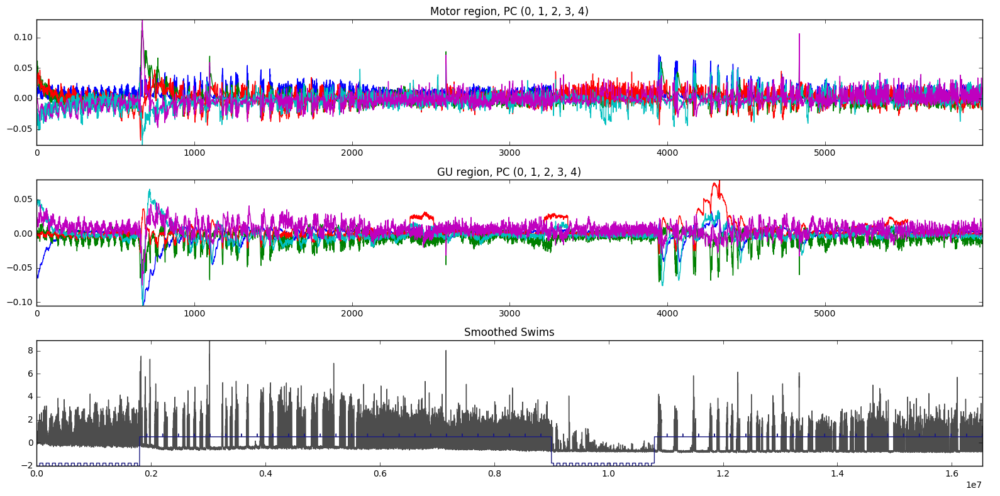

In [37]:
fig, axs = plt.subplots(nrows=3, figsize=(16,8))
plr = slice(0, 6000)
plr_ep = slice(frame_times[plr.start], frame_times[plr.stop])

cur_pc = (0,1,2,3,4)
axs[0].plot(results_pca[0][1][cur_pc, plr].T)
axs[0].set_title('Motor region, PC {0}'.format(cur_pc))

cur_pc = (0,1,2,3,4)
axs[1].plot(-results_pca[1][1][cur_pc, plr].T)
axs[1].set_title('GU region, PC {0}'.format(cur_pc))

axs[2].plot(zscore(flt_swim[plr_ep]), color=[.3,.3,.3])
axs[2].plot(zscore(condition_signal[plr_ep]), color=[.1,.1,.5])
axs[2].set_title('Smoothed Swims')
[ax.axis('tight') for ax in axs]
plt.tight_layout()

In [38]:
region = 1
pca_weights = []
for cmp in range(results_pca[region][0].shape[1]):
    vol = np.zeros(masks[0].shape)
    comp = results_pca[region][0][:, cmp]
    for ind, k in enumerate(ser_keys[region]):
        vol[k] = comp[ind]
    pca_weights.append(vol)

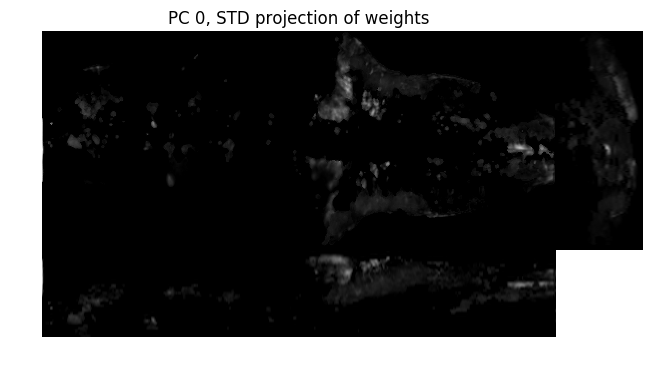

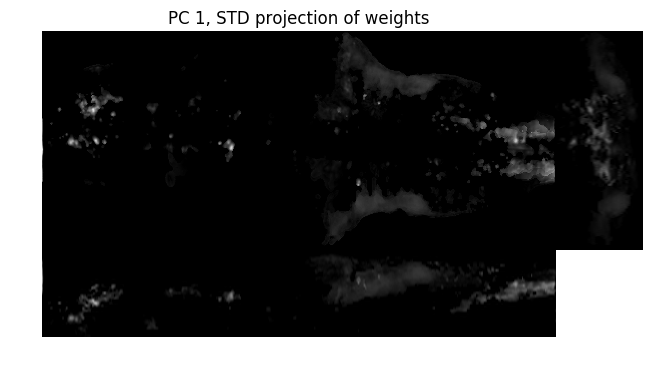

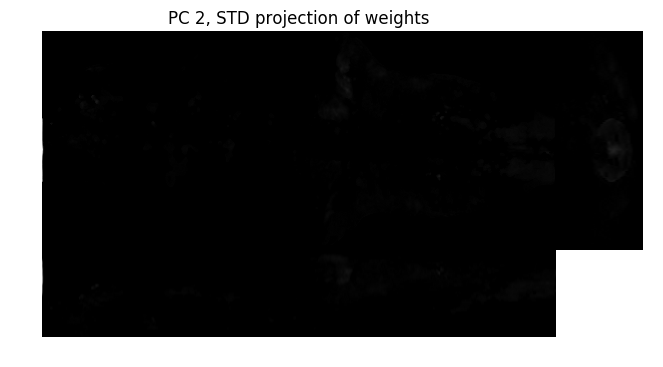

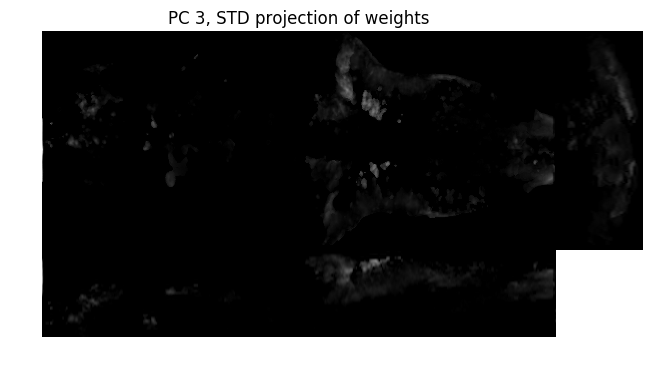

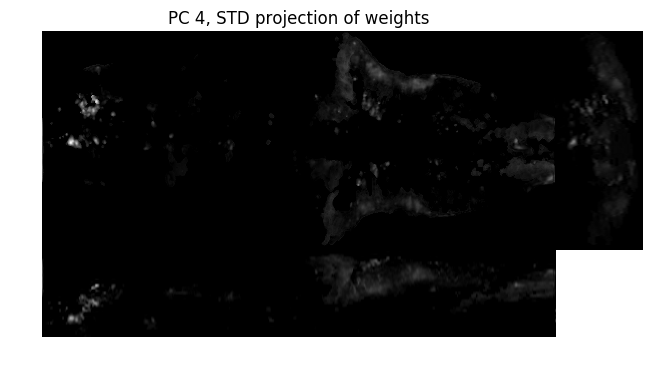

In [39]:
for cmp in range(len(pca_weights)):
    axs = proj_plot(pca_weights[cmp], np.std, aspect=(5,1,1), figsize=6)
    axs[0][0].set_title('PC {0}, STD projection of weights'.format(cmp))

In [83]:
## gu-triggered plots for components

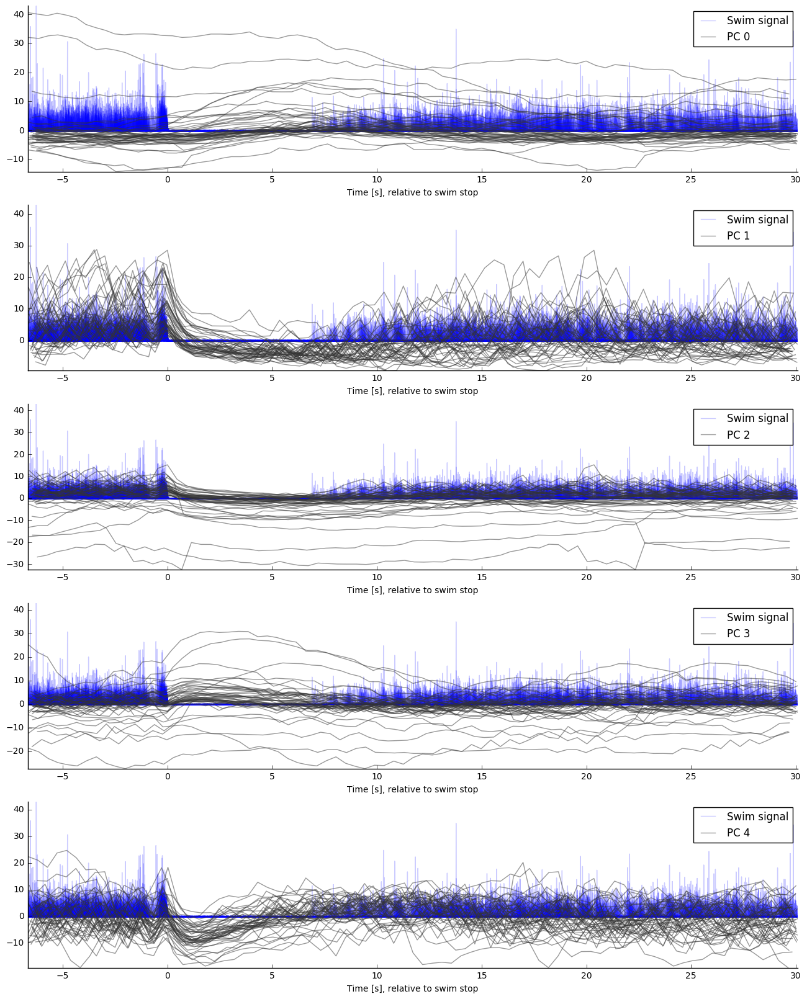

In [40]:
nr = results_pca[0][1].shape[0]
fig, axs = plt.subplots(nrows = nr, figsize=(16,4 * nr))
offset = 0
window_len = 80
fs_ep = 6000
window_ep = np.arange(0, frame_times[window_len]) - 40000
triggers = stops[gu_events]
for cmp in range(nr):
    cur_cmp = cmp
    to_plot = results_pca[1][1][cur_cmp, :]
    for ind, trig in enumerate(triggers):
        ax = axs[cmp]    
        plr_ep  = window_ep + trig    
        plr_im = np.where(np.in1d(frame_times,  plr_ep))[0]
        frame_shift = (plr_ep[0] - frame_times[plr_im[0]])
        xaxis_im  = (frame_times[plr_im] - frame_times[plr_im[0]] - frame_shift + window_ep[0])
    
        ax.plot(window_ep / fs_ep, ind * offset + zscore(swim_signal[plr_ep]), alpha = .2, label='swim', color='b', zorder=0)    
        ax.plot(xaxis_im / fs_ep, ind * offset + 5 * zscore(to_plot)[plr_im], color=[.2,.2,.2], alpha = .5)
        
    ax.axis('tight')
    ax.set_xlabel('Time [s], relative to swim stop')
    ax.legend(('Swim signal','PC {0}'.format(cur_cmp)))
    ax_format(ax)

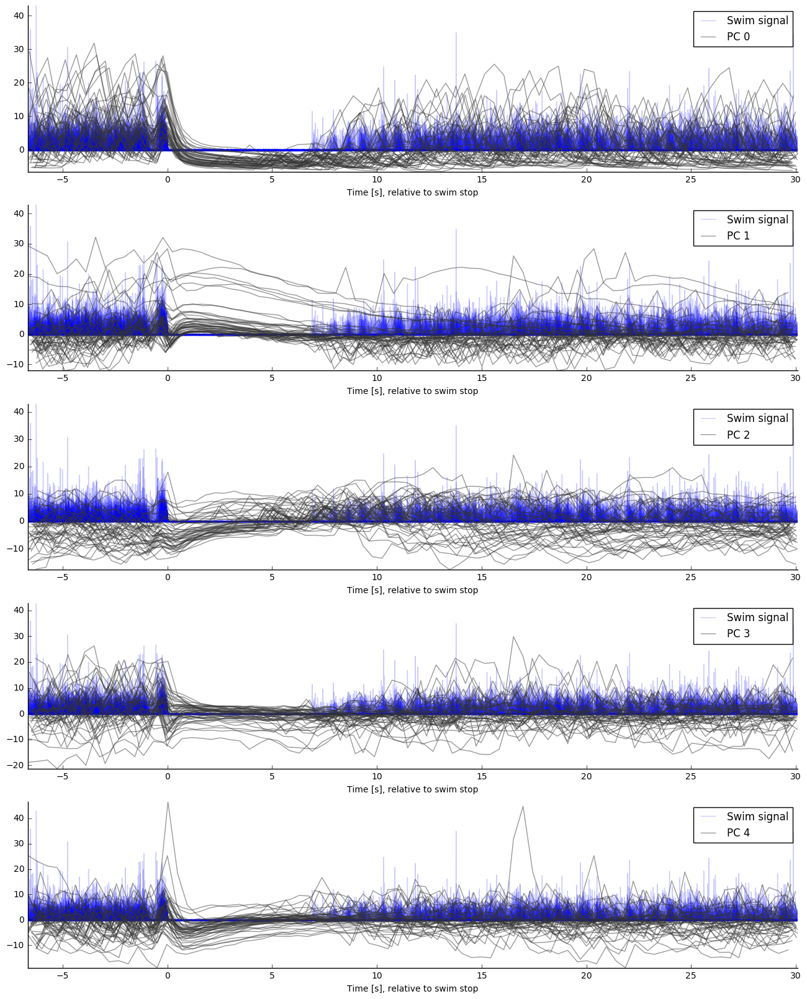

In [42]:
nr = results_pca[0][1].shape[0]
fig, axs = plt.subplots(nrows = nr, figsize=(16,4 * nr))
offset = 0
window_len = 80
fs_ep = 6000
window_ep = np.arange(0, frame_times[window_len]) - 40000
triggers = stops[gu_events]
for cmp in range(nr):
    cur_cmp = cmp
    to_plot = results_pca[0][1][cur_cmp, :]
    for ind, trig in enumerate(triggers):
        ax = axs[cmp]    
        plr_ep  = window_ep + trig
    
        plr_im = np.where(np.in1d(frame_times,  plr_ep))[0]
        frame_shift = (plr_ep[0] - frame_times[plr_im[0]])
        xaxis_im  = (frame_times[plr_im] - frame_times[plr_im[0]] - frame_shift + window_ep[0])
    
        ax.plot(window_ep / fs_ep, ind * offset + zscore(swim_signal[plr_ep]), alpha = .2, label='swim', color='b', zorder=0)    
        ax.plot(xaxis_im / fs_ep, ind * offset + 5 * zscore(to_plot)[plr_im], color=[.2,.2,.2], alpha = .5)
        
    ax.axis('tight')
    ax.set_xlabel('Time [s], relative to swim stop')
    ax.legend(('Swim signal','PC {0}'.format(cur_cmp)))
    ax_format(ax)

In [43]:
from pyspark.mllib.clustering import KMeansModel, KMeans

In [44]:
%%time
km_models = [KMeans.train(s.tordd().values(), k = 50) for s in ser_flt]

CPU times: user 57.1 s, sys: 16.4 s, total: 1min 13s
Wall time: 9min 17s


In [127]:
km_centers = np.array([np.array(km.centers) for km in km_models])

In [45]:
km_maps = []
for ind, km in enumerate(km_models):
    km_maps.append(km.predict(ser_flt[ind].tordd().values()).collect())

In [142]:
km_vols = []
for region in np.arange(len(km_maps)):
    vol = np.zeros(masks[region].shape, dtype='float32')-1
    for ind, k in enumerate(ser_keys[region]):
        vol[k] = km_maps[region][ind]
    km_vols.append(vol)
km_vols = np.array(km_vols)

In [144]:
np.save(base_dir +'kmeans_centers.npy', km_centers)
np.save(base_dir + 'kmeans_maps.npy', km_vols)

In [145]:
km_centers = np.load(base_dir + 'kmeans_centers.npy')
km_vols = np.load(base_dir + 'kmeans_maps.npy')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x2b2e06dc9cf8>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x2b2e17817748>]], dtype=object)

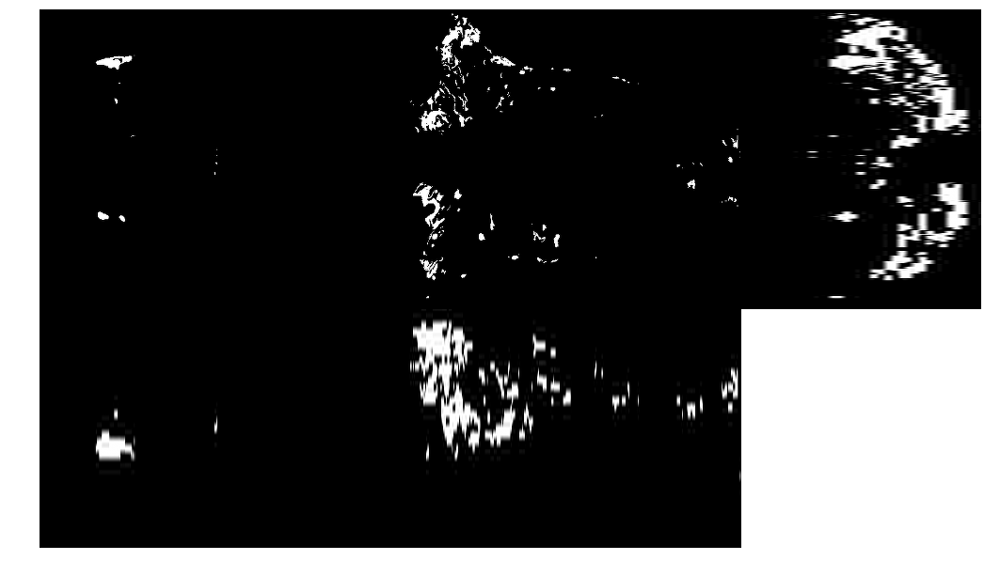

In [158]:
proj_plot(km_vols[1] == 46, np.max, aspect=(10,1,1), figsize=10)

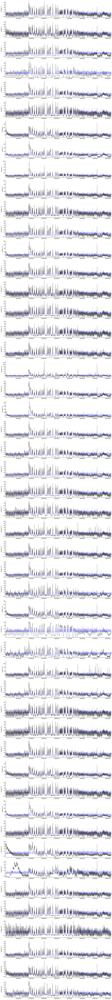

In [153]:
plr = np.arange(0,3000)
to_plot = np.arange(50)
nr = len(to_plot)
fig, axs = plt.subplots(nrows=nr, figsize=(16, nr * 3))
plr_ep = np.arange(frame_times[plr[0]], frame_times[plr[-1]])
for ind, clust in enumerate(to_plot):
    ax = axs[ind]
    ax.plot(plr_ep, zscore(swim_signal[plr_ep]), alpha=.3)
    ax.plot(frame_times[plr], 10*zscore(km_centers[0][clust][plr]),'k', alpha=.6)
    ax.axis('tight')    
    ax_format(ax)
    ax.set_ylabel('Cluster {0}'.format(clust))

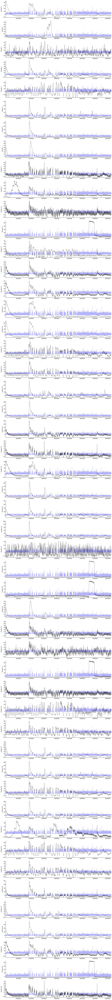

In [154]:
to_plot = np.arange(50)
nr = len(to_plot)
fig, axs = plt.subplots(nrows=nr, figsize=(16, nr * 3))
plr_ep = np.arange(frame_times[plr[0]], frame_times[plr[-1]])
for ind, clust in enumerate(to_plot):
    ax = axs[ind]
    ax.plot(plr_ep, zscore(swim_signal[plr_ep]), alpha=.3)
    ax.plot(frame_times[plr], 10*zscore(km_centers[1][clust][plr]),'k', alpha=.6)
    ax.axis('tight')
    ax_format(ax)
    ax.set_ylabel('Cluster {0}'.format(clust))

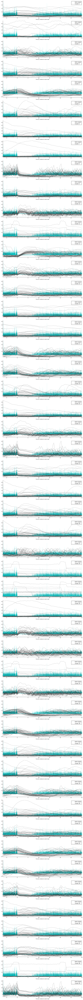

In [163]:
nr = 50
fig, axs = plt.subplots(nrows = nr, figsize=(16,4 * nr))
offset = 0
window_len = 80
fs_ep = 6000
window_ep = np.arange(0, frame_times[window_len]) - 40000
triggers = stops[gu_events]
for cmp in range(nr):
    to_plot = km_centers[1][cmp]
    for ind, trig in enumerate(triggers):
        ax = axs[cmp]    
        plr_ep  = window_ep + trig    
        plr_im = np.where(np.in1d(frame_times,  plr_ep))[0]
        frame_shift = (plr_ep[0] - frame_times[plr_im[0]])
        xaxis_im  = (frame_times[plr_im] - frame_times[plr_im[0]] - frame_shift + window_ep[0])
    
        ax.plot(window_ep / fs_ep, ind * offset + zscore(swim_signal[plr_ep]), alpha = .2, label='swim', color='c', zorder=0)    
        ax.plot(xaxis_im / fs_ep, ind * offset + 5 * zscore(to_plot)[plr_im], color=[.2,.2,.2], alpha = .5)
        
    ax.axis('tight')
    ax.set_xlabel('Time [s], relative to swim stop')
    ax.legend(('Swim signal','Cluster {0}'.format(cmp)))
    ax_format(ax)